# Proyecto 1: Minería de datos
Usando GridSearchCV con Modelo Random Forest Classifier para predecir ausencia en los trabajadores de la empresa ABC

# Contenido

1. [Importar librerias y base de datos](#importar)
2. [Funciones creadas para el programa](#funciones)
3. [Preparación de la base de datos](#preparacion)
4. [Data Profiling](#data_profiling)
    1. [Pandas profiling](#pp)
    2. [Tabla: categóricas](#cat_table)
    3. [Tabla: numéricas](#num_table)
    4. [Observaciones](#obs_profiling)
5. [Gráficas Clave](#graficas)
    1. [Total de ausencias por día de la semana](#t1)
    2. [Porcentaje de ausencias mayores a 4 según el mes](#t4)
    3. [Ausencia de acuerdo a si fuman, beben, ambas o ninguna](#t5)
    4. [Porcentaje de faltas de más de 4 horas según el gasto en transporte](#t7)
    5. [Porcentaje de ausencias mayores de 4 horas según el IMC](#t9)
6. [Separar Datos](#separar)
7. [Modelo 1](#modelo_1)
8. [Modelo 2](#modelo_2)
     1. [Prediction Scores](#prediction)
     2. [Curva ROC y AUC](#ROC)
     3. [Métricas de desempeño](#metricas)
     4. [Punto de corte del modelo](#punto_de_corte)
     5. [Matriz de Confusión](#confusion)

# Importar librerias y base de datos <a name="importar"></a>

In [1]:
## Importar Librerías Necesarias

# Manejo de datos
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import confusion_matrix

## Establecer ubicación de la base de datos y guardarla
datos = pd.read_csv('/Users/zairaramirez/Documents/Mineria/Absenteeism_at_work.csv', sep=';')

# Funciones creadas para el programa <a name="funciones"></a>

In [2]:
def name_changer(col):
    new_col = col.lower()\
    .replace(" ","_")\
    .replace("/","_")
    return new_col

def change_columns_names(df):
    df.rename(columns={col: name_changer(col)
             for col in df.columns.values},
             inplace=True)

def numeric_profiling(df, col):
    profiling = {}
    profiling.update({'valor_minimo': df[col].min(),
                     'valor_maximo': df[col].max(),
                     'valor_promedio': df[col].mean(),
                     'desv_estandar': df[col].std(),
                     '25%': df[col].quantile(.25),
                     'mediana': df[col].median(),
                     '75%': df[col].quantile(.75),
                     'kurtosis': df[col].kurt(),
                     'asimetria': df[col].skew(),
                     'observaciones': df[col].size,
                     'num_unicas': df[col].nunique(),
                     'faltantes': df[col].isna().sum(),
                     '%faltantes': df[col].isna().sum()/df[col].size*100,
                     'observaciones': df[col].size,
                     'moda': get_top(df,col,1)[0]})
    profiling.update({'top'+str(i+1): elemento \
                     for i, elemento in enumerate(get_top(df,col,5))})
    return profiling

def category_profiling(df, col):
    profiling={}
    profiling.update({'num_categorias': df[col].nunique(),
                      'categorias': df[col].unique(),
                      'faltantes': df[col].isna().sum(),
                     '%faltantes': df[col].isna().sum()/df[col].size*100,
                     'observaciones': df[col].size,
                     'moda': get_top(df,col,1)[0]})
    profiling.update({'top'+str(i+1): elemento \
                     for i, elemento in enumerate(get_top(df,col,5))})
    return profiling

def get_top(df,col,top):
    top_5 = df.groupby([col])[col].count()\
    .sort_values(ascending=False).head(top);
    return top_5.index

# Preparación de la base de datos <a name="preparacion"></a>
- Estandarizar el nombre de las columnas para hacer más sencillo su manejo 
- Agregar nueva columna absenteeism_label con la etiqueta 0 si la variable absenteeism_time_in_hours es mayor a 4 y 1 en otro caso
- Eliminar las columnas id, reason_for_absence y absenteeism_time_in_hours
- Eliminar observaciones donde se presuma un error de medición

In [3]:
# Cambiar el nombre de las columnas para hacerlas más sencillas de manejar
change_columns_names(datos)

# Crear columna absenteeism_label
datos['absenteeism_label'] = \
datos.apply(lambda x:  0 if x.absenteeism_time_in_hours > 4 else 1,axis=1)

# Eliminar columnas id, reason_for_absence y absenteeism_time_in_hours
datos.drop(['id','reason_for_absence','absenteeism_time_in_hours'],axis=1,
          inplace=True)

## Mostrar resultado
print(pd.DataFrame(datos.dtypes).reset_index()\
      .rename(columns={'index':'variable',0:'tipo'}))
print('\n\nVariables: {}\nObservaciones:{}'\
      .format(datos.shape[1],datos.shape[0]))

                           variable     tipo
0                  month_of_absence    int64
1                   day_of_the_week    int64
2                           seasons    int64
3            transportation_expense    int64
4   distance_from_residence_to_work    int64
5                      service_time    int64
6                               age    int64
7            work_load_average_day_  float64
8                        hit_target    int64
9              disciplinary_failure    int64
10                        education    int64
11                              son    int64
12                   social_drinker    int64
13                    social_smoker    int64
14                              pet    int64
15                           weight    int64
16                           height    int64
17                  body_mass_index    int64
18                absenteeism_label    int64


Variables: 19
Observaciones:740


Observamos primero el número de valores únicos de cada variable, su tipo y valor máximo y mínimo

In [4]:
mini_resumen_df = pd.DataFrame({'nunique':datos.apply(lambda x: x.nunique()),
                               'dtype':datos.dtypes,
                               'unique':datos.apply(lambda x: x.unique()),
                               'min':datos.apply(lambda x: x.min()),
                               'max': datos.apply(lambda x: x.max())})
mini_resumen_df

,nunique,dtype,unique,min,max
month_of_absence,13,int64,"[7, 8, 9, 10, 11, 12, 1, 2, 3, 4, 5, 6, 0]",0.000,12.000
day_of_the_week,5,int64,"[3, 4, 5, 6, 2]",2.000,6.000
seasons,4,int64,"[1, 4, 2, 3]",1.000,4.000
transportation_expense,24,int64,"[289, 118, 179, 279, 361, 260, 155, 235, 246, ...",118.000,388.000
distance_from_residence_to_work,25,int64,"[36, 13, 51, 5, 52, 50, 12, 11, 25, 29, 16, 27...",5.000,52.000
service_time,18,int64,"[13, 18, 14, 3, 11, 16, 4, 6, 12, 7, 10, 9, 17...",1.000,29.000
age,22,int64,"[33, 50, 38, 39, 28, 36, 34, 37, 41, 47, 29, 4...",27.000,58.000
work_load_average_day_,38,float64,"[239.554, 205.917, 241.476, 253.465, 306.345, ...",205.917,378.884
hit_target,13,int64,"[97, 92, 93, 95, 99, 96, 94, 98, 81, 88, 100, ...",81.000,100.000
disciplinary_failure,2,int64,"[0, 1]",0.000,1.000


Vemos como la variable mes tiene 13 posibles valores, por lo que procederemos a eliminar aquellas observaciones con mes 0 por considerarlo un error de captura

In [5]:
datos = datos[datos.month_of_absence!=0]

# Mostrar resultado
print('Variables: {}\nObservaciones:{}'\
      .format(datos.shape[1],datos.shape[0]))

Variables: 19
Observaciones:737


**¿Cuál es la distribución de la variable absenteeism_label en porcentaje?**

In [6]:
dist_target = datos.absenteeism_label.value_counts(normalize=True)
print('Distribución de la variable objetivo (absenteeism_label) \
en porcentaje\n\n1: {:.2%}\n2: {:.2%}'.format(dist_target[1],dist_target[0]))

Distribución de la variable objetivo (absenteeism_label) en porcentaje

1: 62.14%
2: 37.86%


# Data Profiling <a name="data_profiling"></a>

## Pandas Profiling <a name="pp"></a>

In [7]:
import pandas_profiling

profile = datos.profile_report()
profile

## Profiling table: Variables Categóricas <a name="cat_table"></a>

In [8]:
# Seleccionamos las siguientes variables que convertiremos a categóricas
variables_categoricas = ['month_of_absence','day_of_the_week','seasons','disciplinary_failure',
                        'social_drinker','social_smoker']

# Convertir en categorías
for col in variables_categoricas:
    datos[col] = datos[col].astype('category')

## Category Profiling
category_profiling_df = pd.DataFrame({col: category_profiling(datos,col) 
                                   for col in variables_categoricas})

# Mostrar
category_profiling_df

,month_of_absence,day_of_the_week,seasons,disciplinary_failure,social_drinker,social_smoker
num_categorias,12,5,4,2,2,2
categorias,"[7, 8, 9, 10, 11, ..., 2, 3, 4, 5, 6] Length: ...","[3, 4, 5, 6, 2] Categories (5, int64): [3, 4, ...","[1, 4, 2, 3] Categories (4, int64): [1, 4, 2, 3]","[0, 1] Categories (2, int64): [0, 1]","[1, 0] Categories (2, int64): [1, 0]","[0, 1] Categories (2, int64): [0, 1]"
faltantes,0,0,0,0,0,0
%faltantes,0,0,0,0,0,0
observaciones,737,737,737,737,737,737
moda,3,2,4,0,1,0
top1,3,2,4,0,1,0
top2,2,4,2,1,0,1
top3,10,3,3,NaN,NaN,NaN
top4,7,6,1,NaN,NaN,NaN


## Profiling table: Variables Numéricas <a name="num_table"></a>

In [9]:
## Obtener variables numéricas
variables_numericas = datos.columns.values[[col not in variables_categoricas for col in datos.columns.values]]

## Profiling
numeric_profiling_df = pd.DataFrame({col: numeric_profiling(datos,col) for col in variables_numericas})

# Mostrar
numeric_profiling_df

,transportation_expense,distance_from_residence_to_work,service_time,age,work_load_average_day_,hit_target,education,son,pet,weight,height,body_mass_index,absenteeism_label
valor_minimo,118.000000,5.000000,1.000000,27.000000,205.917000,81.000000,1.000000,0.000000,0.000000,56.000000,163.000000,19.000000,0.000000
valor_maximo,388.000000,52.000000,29.000000,58.000000,378.884000,100.000000,4.000000,4.000000,8.000000,108.000000,196.000000,38.000000,1.000000
valor_promedio,221.514247,29.624152,12.549525,36.419267,271.491339,94.586160,1.293080,1.017639,0.734057,78.983718,172.116689,26.658073,0.621438
desv_estandar,66.960952,14.843701,4.393121,6.461156,39.137634,3.786916,0.674350,1.100130,1.292682,12.866993,6.045341,4.274201,0.485358
25%,179.000000,16.000000,9.000000,31.000000,244.387000,93.000000,1.000000,0.000000,0.000000,69.000000,169.000000,24.000000,0.000000
mediana,225.000000,26.000000,13.000000,37.000000,264.249000,95.000000,1.000000,1.000000,0.000000,83.000000,170.000000,25.000000,1.000000
75%,260.000000,50.000000,16.000000,40.000000,294.217000,97.000000,1.000000,2.000000,1.000000,89.000000,172.000000,31.000000,1.000000
kurtosis,-0.321088,-1.260504,0.670414,0.437662,0.603412,2.395404,2.958363,0.745467,9.505170,-0.910626,7.285587,-0.300909,-1.752993
asimetria,0.394709,0.314339,-0.001710,0.697404,0.959429,-1.257923,2.102144,1.088565,2.698853,0.018906,2.562402,0.305228,-0.501769
observaciones,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000


## Observaciones del data profiling <a name="obs_profiling"></a>
### Variables categóricas
- Las estaciones con mayor número de registros son primavera (26.4%) y otoño (25.9%). La que cuenta con menor registros es verano (23%)
- El día de la semana con mayor número de registros es el lunes (21.8%) mientras que el jueves es el día con menor registros (16.9%)
- 82.6% de los registros pertenecen a personas con preparatoria como grado de escolaridad, se podrían establecer incentivos para disminuir las ausencias en este grupo de personas.

### Variables numéricas
- La edad promedio de los empleados es 37, con una edad mínima de 27 y una máxima de 58
- El gasto promedio en transporte de los empleados es 221, un gasto elevado en transporte se encontraría arriba de 300. El gasto más común es por 179.
- En promedio, la distancia que recorren los empleados desde su casa al trabajo es de 29.6 kilómetros. Las dos distancias más comunes entre los empleados son 26 km (17.3%) y 51 km (16.2%), por lo que podría ser un factor que afecte en las faltas.

# Gráficas Clave <a name="graficas"></a>
Con la finalidad de observar el papel que juegan ciertas variables en el absentismo laboral se generaron las siguientes gráficas:

## Total de ausencias por día de la semana <a name="t1"></a>

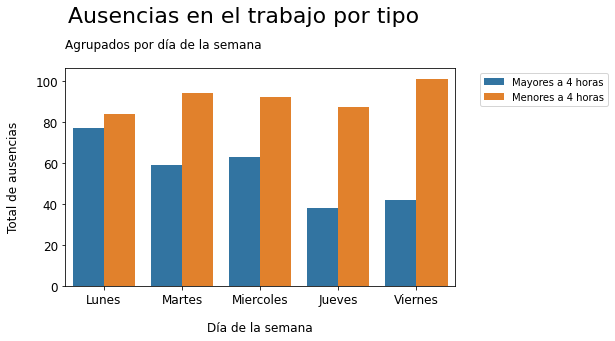

In [10]:
dias = ['Lunes','Martes','Miercoles','Jueves','Viernes']

## Preparación
x = [dias[dia-2] for dia in datos.day_of_the_week]
hue = datos.absenteeism_label.astype('category')\
.cat.rename_categories({0:'Mayores a 4 horas', 1:'Menores a 4 horas'})\
.rename('Ausencias')

## Graficar
fig, ax = plt.subplots(figsize=(7,4))
sns.countplot(x=x,hue=hue,order=dias)


# Cambiar títulos
plt.suptitle(t='Ausencias en el trabajo por tipo',
         y=1.095, fontsize=22, x=.48)
plt.title('Agrupados por día de la semana', loc='left', pad=20)

plt.xlabel('Día de la semana', labelpad=15, fontsize=12)
plt.ylabel('Total de ausencias', labelpad=15, fontsize=12)
plt.yticks(fontsize=12, fontweight=4);
plt.xticks(fontsize=12, fontweight=4)

plt.legend(bbox_to_anchor=(1.05,1));

En la gráfica anterior se observa que el día lunes presenta mayor ausentismo cuando se trata de estar ausente por más de cuatro horas, mientras que el día viernes presenta mayor ausentismo por cuatro horas o menos.

## Porcentaje de ausencias mayores a 4 de acuerdo al mes <a name="t4"></a>

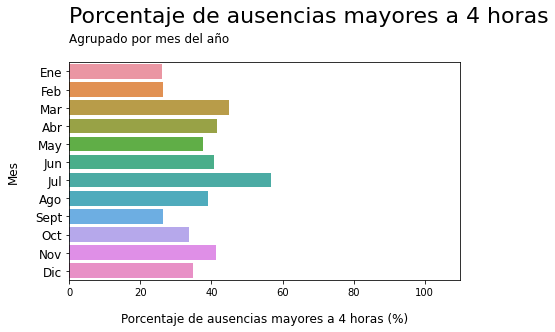

In [11]:
meses = ['Ene','Feb','Mar','Abr','May','Jun',
         'Jul','Ago','Sept','Oct','Nov','Dic']

# Graficar
fig, ax = plt.subplots(figsize=(7,4))
plt.xlim([0,110])

sns.barplot(y=[meses[mes-1] for mes in datos.month_of_absence],
            x=datos.absenteeism_label,
            estimator=lambda x: sum(x==0)*100/len(x), orient='h', ci=None,
           order=meses)

# Cambiar títulos
plt.suptitle(t='Porcentaje de ausencias mayores a 4 horas',
         y=1.075, fontsize=22, x=.60)
plt.title('Agrupado por mes del año', loc='left', pad=20,)

plt.xlabel('Porcentaje de ausencias mayores a 4 horas (%)',
           labelpad=15, fontsize=12)
plt.ylabel('Mes', labelpad=15, fontsize=12)
plt.yticks(fontsize=12, fontweight=4);

Lo mismo se decidió hacer por mes. En la gráfica anterior están los resultados obtenidos, encontramos que el porcentaje de absentismo laboral que pasa por más de 4 horas es mayor para los meses de marzo y julio, mientras que enero y febrero son los meses con menor porcentaje.

## Ausencia de acuerdo a si fuman, beben, ambas o ninguna<a name="t5"></a>

Se podría creer que aquellas personas que son bebedores o fumadores sociales tienden a ausentarse más en el trabajo. Para ello se hizo la siguiente gráfica:

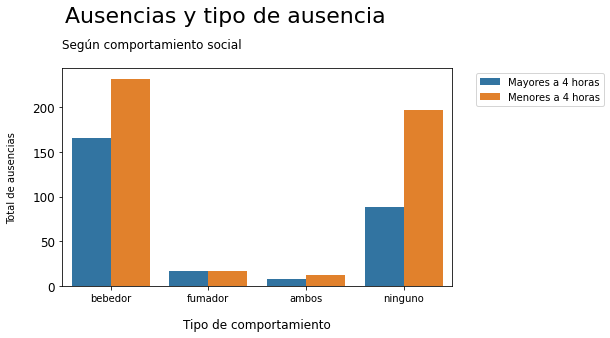

In [12]:
aux = datos.loc[:,['social_drinker','social_smoker','absenteeism_label']]
claves = {'00': 'ninguno',
         '11': 'ambos',
         '10': 'fumador',
         '01': 'bebedor'};

aux['estado'] = [claves[clave] 
                for clave in aux.social_smoker.astype('string')\
                +aux.social_drinker.astype('string')]

hue = aux.absenteeism_label.astype('category')\
.cat.rename_categories({0:'Mayores a 4 horas',1:'Menores a 4 horas'})\
.rename('Ausencias')

# Graficar
fig, ax = plt.subplots(figsize=(7,4))
plt.xlim([0,1])

sns.countplot(x=aux.estado, hue=hue, 
              order=['bebedor','fumador','ambos','ninguno'])

# Cambiar títulos
plt.suptitle(t='Ausencias y tipo de ausencia',
         y=1.095, fontsize=22, x=.45)
plt.title('Según comportamiento social', loc='left', pad=20,)

plt.xlabel('Tipo de comportamiento', labelpad=15, fontsize=12)
plt.ylabel('Total de ausencias', labelpad=15, )
plt.yticks(fontsize=12, fontweight=4);

plt.legend(bbox_to_anchor=(1.4,1));

Aquellas personas que estuvieron ausentes son en su mayoría bebedores sociales; sin embargo, aquellos empleados que no fuman ni consumen alcohol, son el segundo grupo con mayor ausencia para un periodo de tiempo similar. A partir de estos resultados se puede creer que el que sea fumador o bebedor social no aportará mucha información respecto al absentismo laboral.

## Porcentaje de faltas de más de 4 horas según el gasto en transporte <a name="t7"></a>

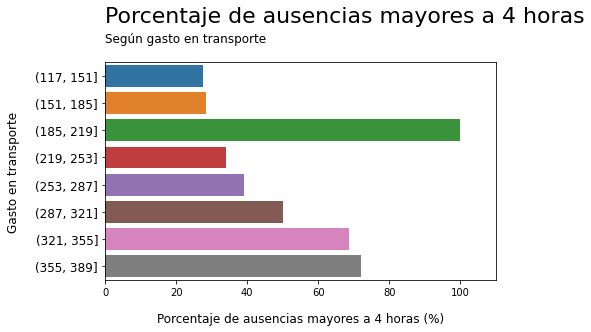

In [13]:
# Graficar
fig, ax = plt.subplots(figsize=(7,4))
plt.xlim([0,110])

sns.barplot(y=pd.cut(datos.transportation_expense,range(117,390,34)),
            x=datos.absenteeism_label,
            estimator=lambda x: sum(x==0)*100/len(x), ci=None)

# Cambiar títulos
plt.suptitle(t='Porcentaje de ausencias mayores a 4 horas',
         y=1.075, fontsize=22, x=.60)
plt.title('Según gasto en transporte', loc='left', pad=20,)

plt.xlabel('Porcentaje de ausencias mayores a 4 horas (%)',
           labelpad=15, fontsize=12)
plt.ylabel('Gasto en transporte', labelpad=15, fontsize=12)
plt.yticks(fontsize=12, fontweight=4);

Se esperaba que el porcentaje de asuncias mayores a 4 horas mostrara crecimiento conforme al incremento en el gasto en transporte; sin embargo, aquellas personas con un gasto entre 185 y 219 son las que presentan mayor absentismo laboral. El comportamiento del resto de los rangos fue el esperado. 

## Porcentaje de ausencias mayores a 4 horas según el Índice de Masa Corporal (IMC) <a name="t9"></a>
Finalmente, es posible creer que los empleados con mayor IMC registran mayor ausencia por problemas médicos desencadenados del sobrepeso. En la siguiente gráfica observamos que los empleados que presentan sobrepeso (IMC entre 26 y 30) y obesidad tipo II (IMC entre 35 y 39) presentan mayor porcentaje de ausencias mayores a 4 horas. Se puede destacar que aquellos con obesidad tipo II cuentan con menor tasa de absentismo en comparación con los considerados con un peso normal.

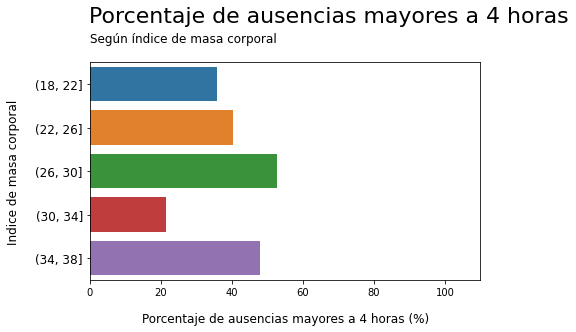

In [14]:
# Graficar
fig, ax = plt.subplots(figsize=(7,4))
plt.xlim([0,110])

sns.barplot(y=pd.cut(datos.body_mass_index,range(18,39,4)),
            x=datos.absenteeism_label,
            estimator=lambda x: sum(x==0)*100/len(x), ci=None)

# Cambiar títulos
plt.suptitle(t='Porcentaje de ausencias mayores a 4 horas',
         y=1.075, fontsize=22, x=.60)
plt.title('Según índice de masa corporal', loc='left', pad=20,)

plt.xlabel('Porcentaje de ausencias mayores a 4 horas (%)',
           labelpad=15, fontsize=12)
plt.ylabel('Indice de masa corporal', labelpad=15, fontsize=12)
plt.yticks(fontsize=12, fontweight=4);

# Separar datos <a name="separar"></a>

In [15]:
# Semilla aleatoria
np.random.seed(20201111)

# Separar datos en predictoras y predecida
X = datos.drop('absenteeism_label',axis=1)
y = datos.absenteeism_label

# Separar datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.25)

## Verificar los tamaños de nuestros 4 sets
print("entrenamiento: X: {}, y: {}".format(X_train.shape, y_train.shape))
print("prueba: X: {}, y: {}".format(X_test.shape, y_test.shape))

entrenamiento: X: (552, 18), y: (552,)
prueba: X: (185, 18), y: (185,)


# Modelo 1 <a name="modelo_1"></a>

In [16]:
grid = {'n_estimators': [100, 300], 'min_samples_leaf':[3,5,7,9,11]}

rf = RandomForestClassifier(oob_score=True, n_jobs=-1)
gs_rf = GridSearchCV(rf, grid, cv=3, scoring='precision', return_train_score=True, n_jobs=-1)

# entrenando los random forest
gs_rf.fit(X_train, y_train);

**¿Cuáles son los hiperparámetros del mejor modelo?**

In [17]:
mejor_modelo_1 = gs_rf.best_estimator_

print('Número de árboles: {}\nMínimo número de elementos para definir una hoja: {}'\
     .format(mejor_modelo_1.n_estimators, mejor_modelo_1.min_samples_leaf))

Número de árboles: 100
Mínimo número de elementos para definir una hoja: 3


**¿Cuál es el valor del OOB? Interpreta**

In [18]:
mejor_modelo_1.oob_score_

0.7355072463768116

De las observaciones que quedaron libres, los pasó como set de validación. El 73.55% de las veces se hizo una predicción correcta

**¿Cuáles son los 5 features que aportan más información?¿Cuánto aporta cada uno?**<br >
**¿Cuáles son los 5 features que aportan menos información?¿Cuánto aporta cada uno?**

In [19]:
feature_importances = mejor_modelo_1.feature_importances_
feature_importances_df = pd.DataFrame({'feature':X.columns.values,
                                     'importance':feature_importances})
feature_importances_df.sort_values(by='importance',ascending=False,inplace=True)
feature_importances_df

,feature,importance
7,work_load_average_day_,0.152652
3,transportation_expense,0.099692
8,hit_target,0.095483
0,month_of_absence,0.083146
1,day_of_the_week,0.078672
6,age,0.066541
5,service_time,0.052343
17,body_mass_index,0.051233
15,weight,0.051231
16,height,0.050904


Los 5 features que aportan más información y su aporte

In [20]:
feature_importances_df[:5].set_index('feature')

,importance
feature,
work_load_average_day_,0.152652
transportation_expense,0.099692
hit_target,0.095483
month_of_absence,0.083146
day_of_the_week,0.078672


Los 5 features que aportan menos información y su aporte

In [21]:
feature_importances_df[-5:].set_index('feature')

,importance
feature,
disciplinary_failure,0.026433
pet,0.023388
social_drinker,0.010976
education,0.009126
social_smoker,0.003734


# Modelo 2 <a name="modelo_2"></a>
Eliminar las columnas que aportan menos del 5% de informacion

In [22]:
# Seleccionar columnas a eliminar
a_eliminar = \
feature_importances_df[feature_importances_df.importance<.05]\
.set_index('feature')

print('Total de variables a eliminar: ', a_eliminar.shape[0])
a_eliminar

Total de variables a eliminar:  8


,importance
feature,
son,0.049539
distance_from_residence_to_work,0.048510
seasons,0.046395
disciplinary_failure,0.026433
pet,0.023388
social_drinker,0.010976
education,0.009126
social_smoker,0.003734


In [23]:
# Eliminar columnas
X_train_2 = X_train.drop(a_eliminar.index,axis=1)
X_test_2 = X_test.drop(a_eliminar.index, axis=1)

## Verificar los tamaños de nuestros 4 sets
print("entrenamiento: X: {}, y: {}".format(X_train_2.shape, y_train.shape))
print("prueba: X: {}, y: {}".format(X_test_2.shape, y_test.shape))

# Entrenando los Random Forest
gs_rf.fit(X_train_2, y_train);

entrenamiento: X: (552, 10), y: (552,)
prueba: X: (185, 10), y: (185,)


**¿Cuáles son los hiperparámetros del mejor modelo?**

In [24]:
mejor_modelo_2 = gs_rf.best_estimator_

print('Número de árboles: {}\nMínimo número de elementos para definir una hoja: {}'\
     .format(mejor_modelo_2.n_estimators, mejor_modelo_2.min_samples_leaf))

Número de árboles: 100
Mínimo número de elementos para definir una hoja: 3


**¿Cuál es el valor de OOB?**

In [25]:
mejor_modelo_2.oob_score_

0.730072463768116

De las observaciones que quedaron libres, los pasó como set de validación. El 73% de las veces se hizo una predicción correcta

# Predicción Base <a name="prediction"></a>

In [26]:
prediction_labels = mejor_modelo_2.predict(X_test_2)
prediction_scores = mejor_modelo_2.predict_proba(X_test_2)

predictions_df = pd.DataFrame({'real_labels':y_test,
                              'predicted_labels':prediction_labels,
                              'scores_low':prediction_scores[:,0],
                              'scores_high':prediction_scores[:,1]})
predictions_df

,real_labels,predicted_labels,scores_low,scores_high
135,1,1,0.107552,0.892448
538,0,1,0.264055,0.735945
501,1,1,0.129286,0.870714
697,0,0,0.608657,0.391343
675,1,0,0.694589,0.305411
...,...,...,...,...
598,1,1,0.279517,0.720483
130,0,0,0.800423,0.199577
335,0,1,0.315471,0.684529
79,1,1,0.123804,0.876196


# Curva ROC y AUC <a name="ROC"></a>



AUC:  0.6999026053080107


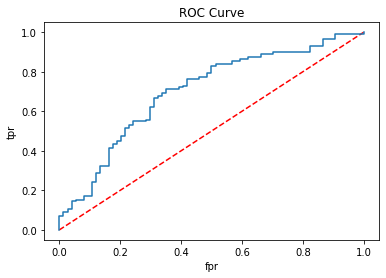

In [27]:
# Generar puntos
fpr, tpr, thresholds = roc_curve(y_test, prediction_scores[:,1], pos_label=1)

# Graficar
plt.clf();
plt.plot([0,1],[0,1], 'k--', c="red")
plt.plot(fpr,tpr)
plt.title("ROC Curve")
plt.xlabel("fpr")
plt.ylabel("tpr");

# AUC: mostrar
print('\n\nAUC: ', roc_auc_score(y_test, prediction_scores[:,1]))

### AUC
Con 69.99%, el modelo es capaz de predecir correctamente el absentismo laboral según los dos posible valores (ausente más de cuatro horas y ausente por menos de cuatro horas) 

# Tabla de métricas de desempeño <a name="metricas"></a>
Genera las tabla de métricas de desempeño que incluya: el _score_ del modelo

In [28]:
# Encontrar el total de positivos y negativos en la muestra
total_positivos = y_test.sum()
total_negativos = y_test.count()-total_positivos

# Obtener métricas relevantes
metricas_df = pd.DataFrame({'threshold':thresholds,
                           'tpr':tpr,
                           'fpr':fpr,
                           'tnr': 1-fpr,
                           'fnr': 1-tpr})
metricas_df['precision'] = metricas_df.apply(lambda x: x.tpr/(x.tpr+x.fpr), axis=1)
metricas_df['recall'] = tpr
metricas_df['f1_score'] = 2*(metricas_df.precision*metricas_df.recall/(metricas_df.precision+metricas_df.recall))

metricas_df

/Users/zairaramirez/.pyenv/versions/itam_md/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in double_scalars
  # This is added back by InteractiveShellApp.init_path()


,threshold,tpr,fpr,tnr,fnr,precision,recall,f1_score
0,1.992615,0.000000,0.000000,1.000000,1.000000,NaN,0.000000,NaN
1,0.992615,0.009009,0.000000,1.000000,0.990991,1.000000,0.009009,0.017857
2,0.983523,0.036036,0.000000,1.000000,0.963964,1.000000,0.036036,0.069565
3,0.982325,0.054054,0.000000,1.000000,0.945946,1.000000,0.054054,0.102564
4,0.974364,0.072072,0.000000,1.000000,0.927928,1.000000,0.072072,0.134454
...,...,...,...,...,...,...,...,...
81,0.274785,0.963964,0.864865,0.135135,0.036036,0.527094,0.963964,0.681529
82,0.245906,0.963964,0.905405,0.094595,0.036036,0.515663,0.963964,0.671900
83,0.204668,0.990991,0.905405,0.094595,0.009009,0.522565,0.990991,0.684292
84,0.137721,0.990991,1.000000,0.000000,0.009009,0.497738,0.990991,0.662651


# Punto de corte del modelo <a name="punto_de_corte"></a>
Solo podemos tener un máximo de 5% de errores del estilo: El modelo predice que el empleado se ausentará menos de 5 horas pero el empleado se ausentó por más de 4 horas.

**En otras palabras un máximo de 5% de falsos positivos.**<br><br>
**¿Cuál es el punto de corte de este modelo?**

In [29]:
# Obtener el punto de corte
punto_de_corte = metricas_df[metricas_df.fpr <= .05][-1:]
punto_de_corte

,threshold,tpr,fpr,tnr,fnr,precision,recall,f1_score
10,0.947347,0.144144,0.040541,0.959459,0.855856,0.780488,0.144144,0.243346


**En este punto de corte ¿cuánto tiene de eficiencia y cobertura? Interpreta**

In [30]:
print('Eficiencia: {:.2%}\nCobertura: {:.2%}'\
      .format(punto_de_corte.iloc[0].precision,
              punto_de_corte.iloc[0].recall))

Eficiencia: 78.05%
Cobertura: 14.41%


En este punto el recall es muy bajo, solo vas a identificar correctamente al 14.41% de las personas que no se ausentan más de 4 horas. Por otro lado, la precisión indica que 78.05% de los identificados como personas que no se ausentan más de 4 horas, son correctos.

**En este punto de corte ¿cuánto tiene de tpr, fpr, tnr, fnr?**

In [31]:
print('tpr: {:.2%}\nfpr: {:.2%}\ntnr: {:.2%}\nfnr: {:.2%}'\
     .format(punto_de_corte.iloc[0].tpr,
             punto_de_corte.iloc[0].fpr,
             punto_de_corte.iloc[0].tnr,
             punto_de_corte.iloc[0].fnr))

tpr: 14.41%
fpr: 4.05%
tnr: 95.95%
fnr: 85.59%


**En este punto de corte ¿cuántas etiquetas positivas tendremos en el conjunto de pruebas?**

In [32]:
punto_de_corte_labels = [1 if score >= punto_de_corte.iloc[0].threshold 
                        else 0 for score in prediction_scores[:,1]]
print('Número de etiquetas positivas: {}'.\
      format(sum(punto_de_corte_labels)))

Número de etiquetas positivas: 19


# Matriz de Confusión <a name="confusion"></a>
**En este punto de corte ¿cuál es la matriz de confusión? Interpreta**

In [33]:
matrix = confusion_matrix(y_test, punto_de_corte_labels)
matrix

array([[71,  3],
       [95, 16]])

In [34]:
print('True Negatives: {}\nTrue Positives: {}\
\nFalse Negatives: {}\nFalse Positives: {}'\
      .format(matrix[0,0],matrix[1,1],matrix[1,0],matrix[0,1]))

True Negatives: 71
True Positives: 16
False Negatives: 95
False Positives: 3


El modelo es mejor para detectar los negativos que los positivos. Este modelo está hecho para localizar a los empleados que van a faltar, no tanto para encontrar y tal vez recompensar a aquellos empleados que no van a faltar.